In [1]:
import os
import glob
from dicompylercore import dicomparser as dp
import torch
from torchvision.transforms import ToTensor
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np
import cv2
import pydicom
import re

def get_rt_parser(ruta):
    # Crear diccionario para almacenar los rt_parsers
    rt_parsers = {'RTSTRUCT': None, 'RTDOSE': None, 'CT': []}

    # Obtener la lista de archivos dicom dentro de la subcarpeta del paciente
    archivos_dicom = glob.glob(os.path.join(ruta, "*.dcm*"))

    # Procesar cada archivo DICOM
    for archivo_dicom in archivos_dicom:
        # Crear el path completo al archivo DICOM
        ruta_dicom = os.path.join(ruta, archivo_dicom)
        # Crear un objeto DicomParser para el archivo DICOM
        dicom_parser = dp.DicomParser(ruta_dicom)
        series_info = dicom_parser.GetSeriesInfo()

        # Verificar el atributo 'Modality' 
        if series_info['modality'] == 'CT':
            rt_parsers['CT'].append(dicom_parser)
        elif series_info['modality'] == 'RTSTRUCT':
            rt_parsers['RTSTRUCT'] = dicom_parser
        elif series_info['modality'] == 'RTDOSE':
            rt_parsers['RTDOSE'] = dicom_parser

    return rt_parsers

def detectar_etiqueta(texto, etiqueta):
    patrones = [
        r'\b{}\b'.format(etiqueta),
        r'\b[^\s]*{}[^\s]*\b'.format(etiqueta),  
    ]

    for patron in patrones:
        coincidencias = re.findall(patron, texto, flags=re.IGNORECASE)
        if coincidencias:
            return coincidencias[0] 

    return None

def get_dic_posiciones(rt_parsers):  
    dic_posiciones = dict()
    structure_parser = rt_parsers['RTSTRUCT']
    structures = structure_parser.GetStructures()
    
    for referencia in ['PTV', 'vejiga', 'recto', 'cuerpo']:
        for posicion, dic_info in structures.items():
            match = detectar_etiqueta(dic_info['name'], referencia)
            if match is not None: 
                dic_posiciones[referencia] = posicion
                
    return dic_posiciones, structure_parser

def get_coordenadas(dic_posiciones, structure_parser):
    dic_coordenadas = dict()
    dic_coordenadas_ok = dict()

    for etiqueta, posicion in dic_posiciones.items():
        coordenadas = structure_parser.GetStructureCoordinates(posicion) 
        dic_coordenadas[etiqueta] = coordenadas

    for etiqueta, coordenadas_sucias in dic_coordenadas.items():
        dic_aux = dict()  # Inicializar dic_aux en cada iteración del bucle exterior
        for z, lista_diccionarios in coordenadas_sucias.items():
            data = lista_diccionarios[0]['data']
            dic_aux[z] = data
        dic_coordenadas_ok[etiqueta] = dic_aux 

    return dic_coordenadas_ok

def get_tensor_ct(rt_parsers):
    informacion_cortes = dict()
    ct_parsers = rt_parsers['CT']
    
    for ct_parser in ct_parsers:
        coordenada_z = ct_parser.GetImageLocation()
        datos_ct = ct_parser.GetImageData()
        imagen_ct = ct_parser.GetImage()

        # Acceder a las filas y columnas
        filas = datos_ct['rows']
        columnas = datos_ct['columns']

        # Almacenar la información en el diccionario
        informacion_cortes[coordenada_z] = {'coordenada_z': coordenada_z, 'imagen_ct': imagen_ct}
        
    # Obtener las coordenadas Z ordenadas
    coordenadas_z_ordenadas = sorted(informacion_cortes.keys())
    profundidad = len(coordenadas_z_ordenadas)
    
    # Crear un tensor RGB 
    tensor_rgb = torch.zeros((profundidad, filas, columnas, 3), dtype=torch.float32)

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()
    
    for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
        # Acceder a la imagen CT del diccionario
        imagen_ct = informacion_cortes[coordenada_z]['imagen_ct']
    
        # Convertir la imagen a tensor
        tensor_imagen_ct = to_tensor(imagen_ct)
    
        # Asignar la imagen CT al canal B del tensor RGB
        tensor_rgb[i, :, :, 2] = tensor_imagen_ct[0]  

    return tensor_rgb, filas, columnas, coordenadas_z_ordenadas

def get_tensor_estructuras(dic_coordenadas, tensor_rgb, filas, columnas, coordenadas_z_ordenadas):
    dic_mascaras = dict()
    dic_coordenadas_sinz_estructuras = dict()
    # vamos a preparar las coordenadas para conseguir las mascaras
    for estructura, coordenadas in dic_coordenadas.items():
        coordenadas_sinz = dict()
        
        # Iterar sobre los cortes y coordenadas
        for corte, coordenadas_conz in coordenadas.items():
            # Convertir a numpy array
            coordenadas_conz = np.array(coordenadas_conz, dtype=float)
            coordenadas_sin_z = coordenadas_conz[:, :2]
            # guardar las coordenadas por su z
            coordenadas_sinz[corte] = coordenadas_sin_z
            
        dic_coordenadas_sinz_estructuras[estructura] = coordenadas_sinz
    #print('prueba', dic_coordenadas_sinz_estructuras['cuerpo']) #HASTA ACA ANDA 

    # vamos a formar las mascaras de las estructuras
    for estructura, coordenadas_sinz in dic_coordenadas_sinz_estructuras.items():
        dic_mascaras_aux = dict()
        for corte, coordenadas in coordenadas_sinz.items():
            # Centrar la figura (ajustar al centro de la imagen)
            coordenadas[:, :2] += [columnas // 2, filas // 2]
            coordenadas_ajustadas = (coordenadas).astype(np.int32)
            # Crear una imagen en blanco
            img = np.zeros((filas, columnas), dtype=np.uint8)
            
            # Dibujar el polígono en la imagen
            cv2.fillPoly(img, [coordenadas_ajustadas], 255)

            #guardamos
            dic_mascaras_aux[corte] = img
        dic_mascaras[estructura] = dic_mascaras_aux

    #print("coordenadas z ordenadas", coordenadas_z_ordenadas)
    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()
    # vamos a cargar las mascaras en el tensor
    
    for estructuras, dic_masc in dic_mascaras.items():
       
        for corte, mascara in dic_masc.items(): 
            corte_2 = round(float(corte), 2)
            for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
                if estructuras == "PTV" and corte_2 == coordenada_z:
                    #Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la mascara al canal G del tensor RGB
                    tensor_rgb[i, :, :, 1] = tensor_mascara
                    
                if estructuras == "recto" and corte_2 == coordenada_z:
                    # Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la imagen CT al canal B del tensor RGB
                    tensor_rgb[i, :, :, 0] = tensor_rgb[i, :, :, 0] + tensor_mascara
                    
                if estructuras == "vejiga" and corte_2 == coordenada_z:
                    # Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la imagen CT al canal B del tensor RGB
                    tensor_rgb[i, :, :, 0] = tensor_rgb[i, :, :, 0] + tensor_mascara*0.75

    # Normalizar entre 0 y 1
    tensor_rgb_normalized = torch.div(tensor_rgb, tensor_rgb.max()) # ver despues como normaliza el autor 
                         
    return tensor_rgb_normalized, dic_coordenadas_sinz_estructuras

def get_tensor_recortado(tensor_rgb_normalized, dic_coordenadas_sinz_estructuras):
    mascaras_rectan = dict()
    lista_x = []
    lista_y = []
    lista_xw = []
    lista_yh = []

    for corte, coordenadas in dic_coordenadas_sinz_estructuras["cuerpo"].items():
        coordenadas1 = [coordenadas.astype(int)]
        x, y, w, h = cv2.boundingRect(coordenadas1[0])
        lista_x.append(x)
        lista_y.append(y)
        lista_xw.append(x + w)
        lista_yh.append(y + h)

    min_x = min(lista_x)
    min_y = min(lista_y)
    max_xw = max(lista_xw)
    max_yh = max(lista_yh)

    tensor_recortado = tensor_rgb_normalized[:, min_y - 4 : max_yh + 4, min_x - 4 : max_xw + 4, :]

    return tensor_recortado

def get_tensor_dosis(rt_parsers, coordenadas_z_ordenadas):
    dic_dosis = dict()
    profundidad = len(coordenadas_z_ordenadas)

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()

    dosis_parser = rt_parsers['RTDOSE']

    data_dosis = dosis_parser.GetDoseData()

    print(data_dosis)

    for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
        dosis_array = np.array(dosis_parser.GetDoseGrid(coordenada_z), dtype=float)
        shape = dosis_array.shape
        filas = shape[0]
        columnas = shape[1]
        tensor = to_tensor(dosis_array)
        dic_dosis[i] = tensor

    # Crear un tensor
    tensor_dosis = torch.zeros((profundidad, filas, columnas), dtype=torch.float32)
    for i, tensord in dic_dosis.items():
        tensor_dosis[i, :, :] = tensord

    # Normalizar entre 0 y 1
    tensor_dosis_normalized = torch.div(tensor_dosis, tensor_dosis.max())  # ver después cómo normaliza el autor

    return tensor_dosis_normalized



if __name__ == "__main__":
    
    # Ruta de la carpeta raíz donde se encuentran las subcarpetas de los pacientes
    root_folder = r"C:\Users\ortma\Desktop\FACULTAD\PI\ARCHIVOS_DICOM"
    
    # Ruta de la carpeta donde se crearán las subcarpetas de salida
    output_root_folder = r"C:\Users\ortma\Desktop\FACULTAD\PI\TENSORES PACIENTES"
    
    # Obtener la lista de subcarpetas (pacientes) dentro de la carpeta raíz
    subfolders = sorted(next(os.walk(root_folder))[1])
    
    # Iterar sobre cada subcarpeta (paciente)
    for subfolder in subfolders:
        patient_folder = os.path.join(root_folder, subfolder)
        output_folder = os.path.join(output_root_folder, subfolder)
    
        # Crear la subcarpeta de salida si no existe
        os.makedirs(output_folder, exist_ok=True)
    
        # llamamos a la funcion que devuelve un diccionario con los rt parsers
        rt_parsers = get_rt_parser (patient_folder)
        
        # llamamos a la funcion que nos devuelve un diccionario de posiciones y el structure_parser, la misma tiene como argumento los rt_parsers
        dic_posiciones, structure_parser = get_dic_posiciones(rt_parsers)
        
        # llamamos a la funcion que nos devuelve el diccionario de coordenadas de cada estructura, tiene como argumento el diccionario de posiciones y structure_parser
        dic_coordenadas = get_coordenadas(dic_posiciones, structure_parser)
        
        # llamamos a la funcion que nos devuelve el tensor rgb (con la CT cargada en el canal B) y otras variables de utilidad, tiene como argumento los rt_parsers
        tensor_rgb, filas, columnas, coordenadas_z_ordenadas = get_tensor_ct(rt_parsers)
        
        # llamamos a la funcion que nos devuelve el tensor rgb normalizado, con las estructuras y CT cargados en los canales correspondientes. 
        tensor_rgb_normalized, dic_coordenadas_sinz_estructuras = get_tensor_estructuras(dic_coordenadas, tensor_rgb, filas, columnas, coordenadas_z_ordenadas)
        
        # llamamos a la funcion que nos devuelve el tensor recortado con dimensiones de [x,128,128,3]
        tensor_recortado_rgb = get_tensor_recortado(tensor_rgb_normalized, dic_coordenadas_sinz_estructuras)
        
        # llamamos a la funcion que nos devuelve el tensor de dosis normalizado 
        tensor_dosis_normalized = get_tensor_dosis(rt_parsers, coordenadas_z_ordenadas)
    
        # Obtener el nombre del archivo sin la ruta y la extensión
        filename = os.path.splitext(os.path.basename(subfolder))[0]
        
        # Construir la ruta de salida para el tensor rgb
        output_file_rgb = os.path.join(output_folder, filename + "_rgb" + ".pt")
    
        # Construir la ruta de salida para el tensor dosis
        output_file_dosis = os.path.join(output_folder, filename + "_dosis" + ".pt")
        
        # Guardar el tensor como archivo
        torch.save(tensor_recortado_rgb, output_file_rgb)
    
        print("Tensor rgb guardado en:", output_file_rgb)
        
         # Guardar el tensor como archivo
        torch.save(tensor_dosis_normalized, output_file_dosis)
        
        print("Tensor dosis guardado en:", output_file_dosis)
    

    



{'position': [-186.7856897, -176.4870409, -165.25], 'orientation': [1, 0, 0, 0, 1, 0], 'pixelspacing': [2.5, 2.5], 'rows': 113, 'columns': 148, 'samplesperpixel': 1, 'photometricinterpretation': 'MONOCHROME2', 'littlendian': True, 'frames': 123, 'doseunits': 'GY', 'dosetype': 'PHYSICAL', 'dosecomment': '', 'dosesummationtype': 'PLAN', 'dosegridscaling': '3.6391545e-05', 'dosemax': 1061896.0, 'lut': (array([-186.7856897, -184.2856897, -181.7856897, -179.2856897,
       -176.7856897, -174.2856897, -171.7856897, -169.2856897,
       -166.7856897, -164.2856897, -161.7856897, -159.2856897,
       -156.7856897, -154.2856897, -151.7856897, -149.2856897,
       -146.7856897, -144.2856897, -141.7856897, -139.2856897,
       -136.7856897, -134.2856897, -131.7856897, -129.2856897,
       -126.7856897, -124.2856897, -121.7856897, -119.2856897,
       -116.7856897, -114.2856897, -111.7856897, -109.2856897,
       -106.7856897, -104.2856897, -101.7856897,  -99.2856897,
        -96.7856897,  -94.2856

In [3]:
tensor_1 = torch.zeros(32,2,6)
tensor_2 = torch.zeros(5,2,6)

In [4]:
var_1 = {"imagen": tensor_1, "dosis": tensor_2}

In [5]:
torch.save(var_1, "prueba.pt")

-----------------------------------------------------------------------------------------------------------
Mostramos el tensor rgb recortado


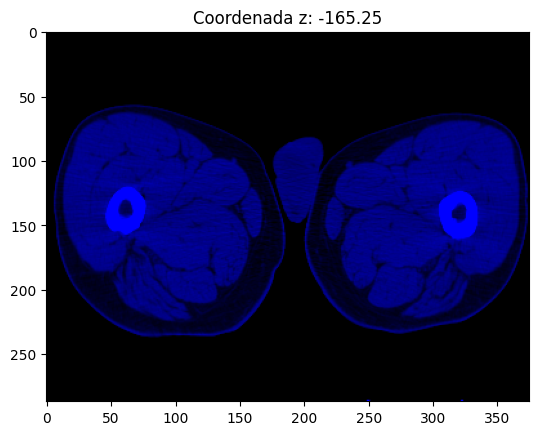

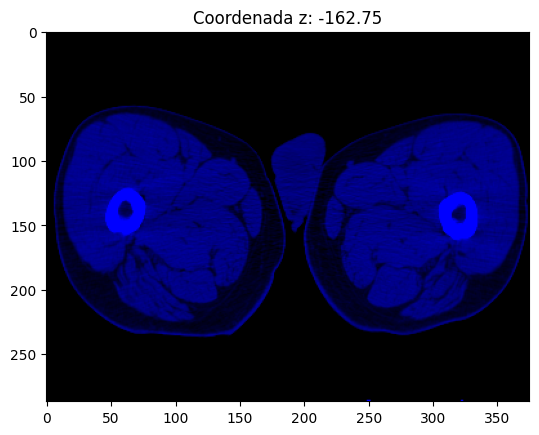

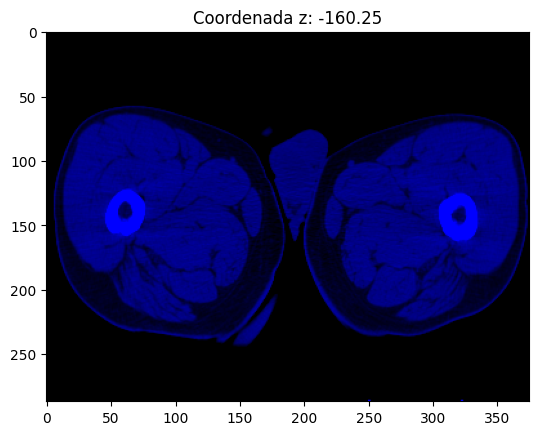

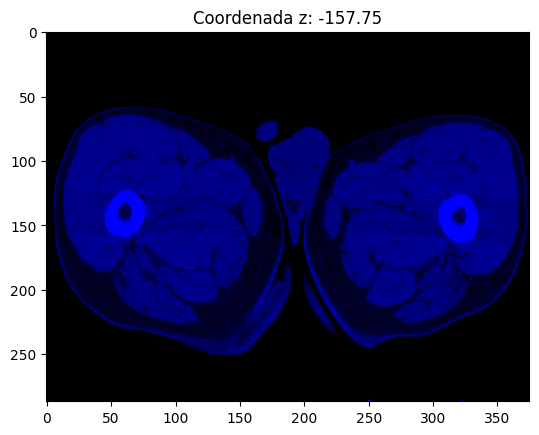

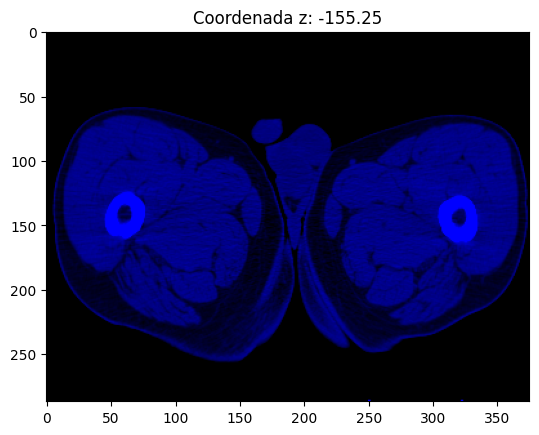

...

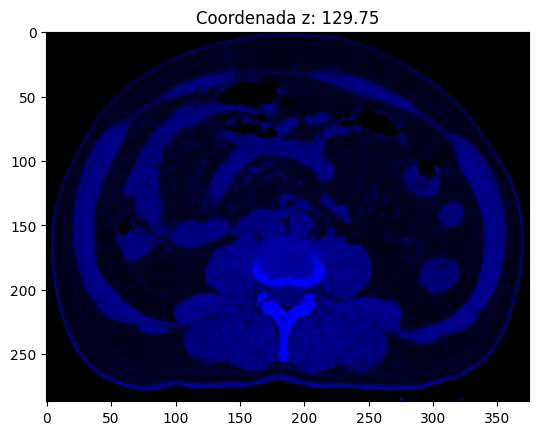

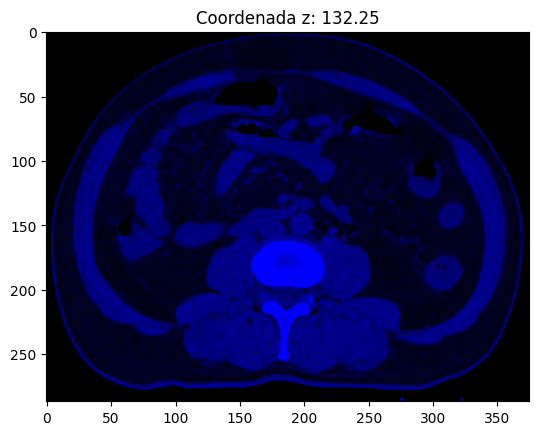

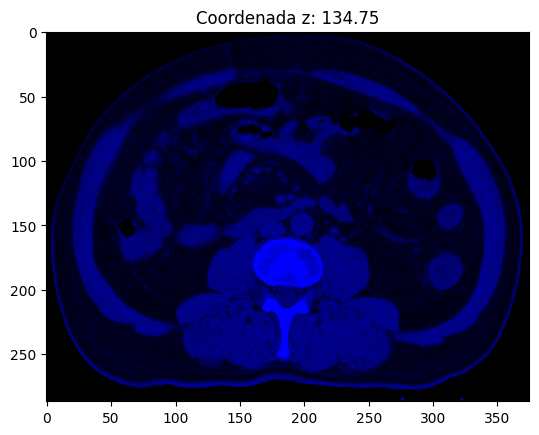

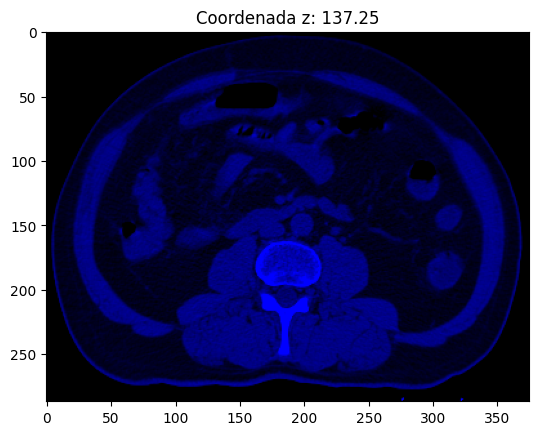

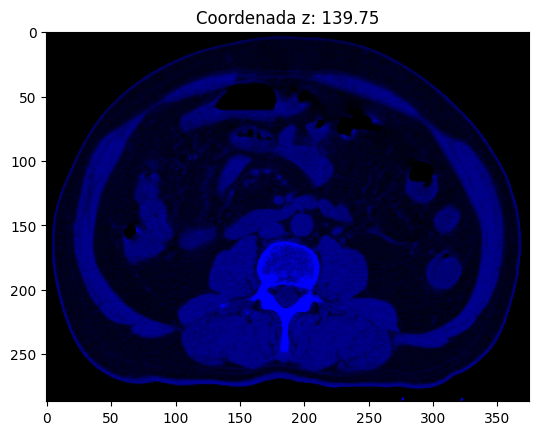

-----------------------------------------------------------------------------------------------------------


In [3]:
# graficamos los resultados obtenidos 

print("-----------------------------------------------------------------------------------------------------------")
print("Mostramos el tensor rgb recortado")
    
for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
    corte_normalizado = tensor_recortado[i].numpy()
    plt.imshow(corte_normalizado)
    plt.title(f'Coordenada z: {coordenada_z}')
    plt.show()
                    
print("-----------------------------------------------------------------------------------------------------------")


In [6]:
print('tensor rgb', tensor_recortado.shape)

print('tensor dosis', tensor_dosis_normalized.shape)

tensor rgb torch.Size([123, 287, 375, 3])
tensor dosis torch.Size([123, 113, 148])


-----------------------------------------------------------------------------------------------------------
Mostramos el tensor dosis


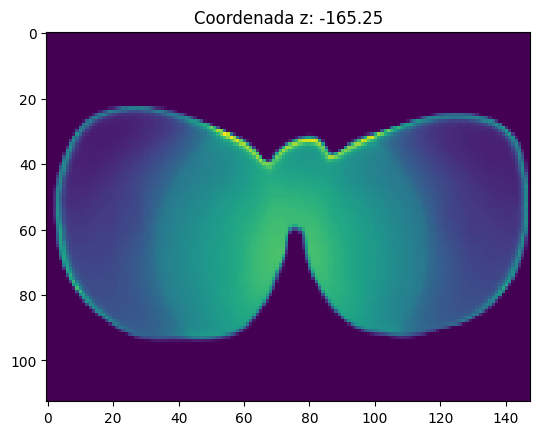

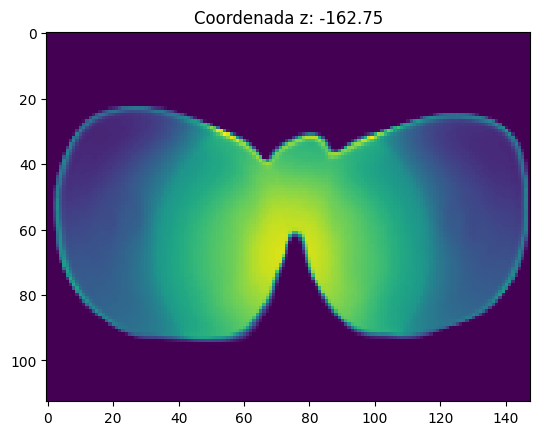

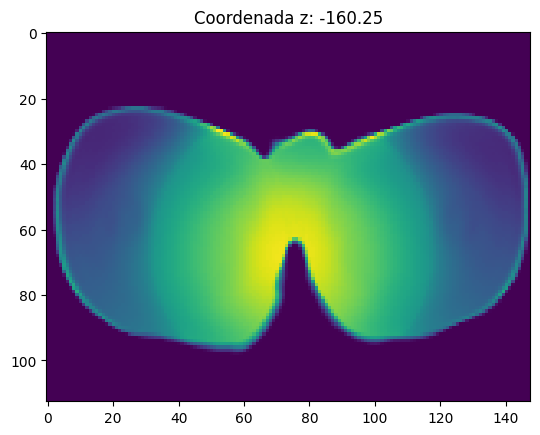

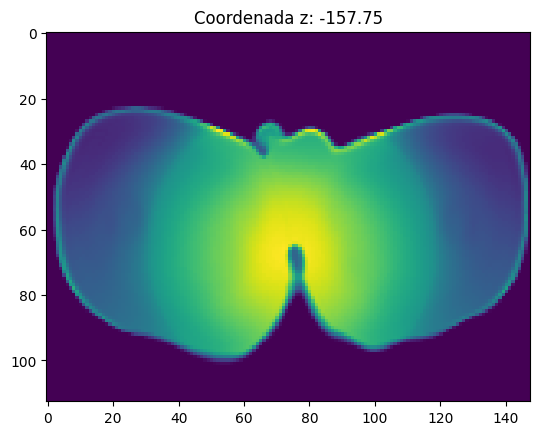

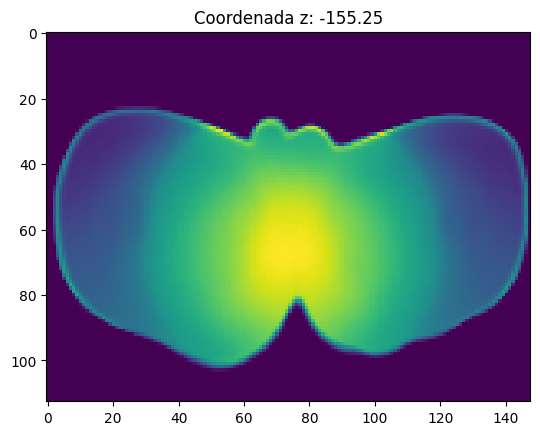

...

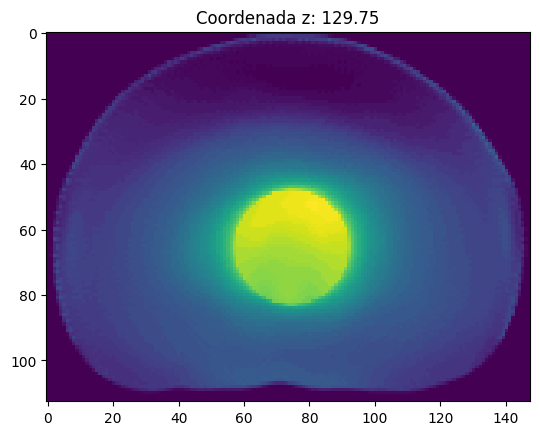

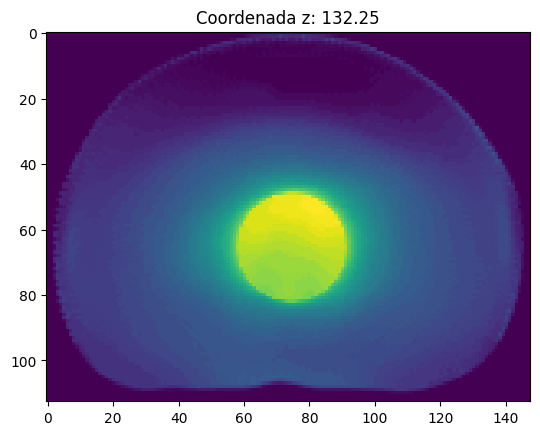

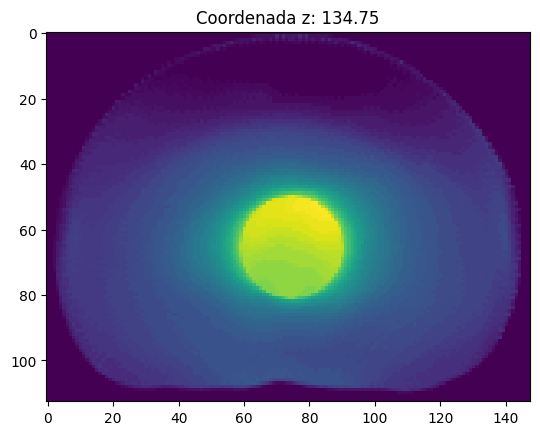

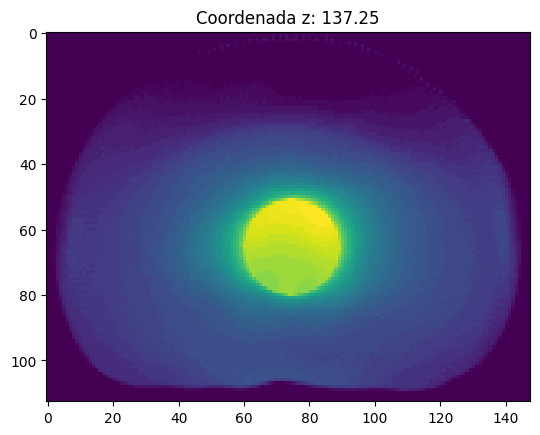

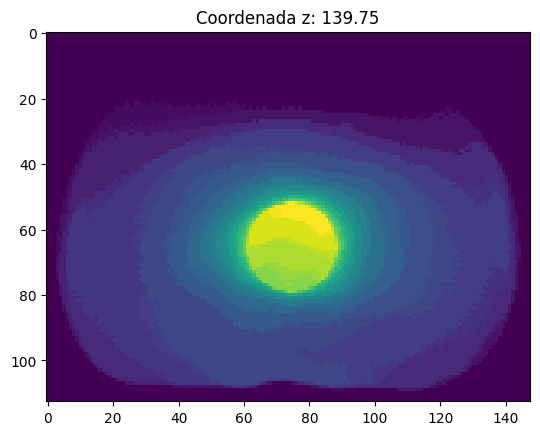

-----------------------------------------------------------------------------------------------------------


In [5]:
print("-----------------------------------------------------------------------------------------------------------")
print("Mostramos el tensor dosis")
    
for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
    corte_normalizado = tensor_dosis_normalized[i].numpy()
    plt.imshow(corte_normalizado)
    plt.title(f'Coordenada z: {coordenada_z}')
    plt.show()
                    
print("-----------------------------------------------------------------------------------------------------------")

In [ ]:
# cosas q faltan hacer: 
# redimencionar los tensores y normalizarlos de acuerdo al paper 
# crear el codigo que recorre todas las carpetas de pacientes y aplica las funciones (listo!)
# guardar los tensores rgb y dosis juntos por paciente (no se tienen que mezclar) (maso)

# ver como hacemos data augmentation (ver paper)

# ver teorico de deep learning 
# las bases del deep learning, conceptos
# Estructura de la GAN 
# chequear el dcm (:()


# preguntas a nehuen
# mail de conrrado
# ct y dosis , necesario?
# utilidad de correr los archivos directamente desde drive 